Время выполнения всех заданий на GPU < 20мин.



# Вспомогательный код

Зафиксируем seeds для воспроизводимости результатов экспериментов.

In [ ]:
import numpy as np
import random
import torch


def set_random_seed(seed):
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    np.random.seed(seed)
    random.seed(seed)


set_random_seed(42)

# Задание 1. Функция свертки

Реализуйте функцию свёртки `conv(x, kernel, pad)`, где:

* $\text{x}$ — двумерный массив размером $(W,H)$;
* $\text{kernel}$ — ядро свёртки размером $(K_w, K_h)$;
* $\text{pad}$ — ширина дополнения с каждой из сторон массива, $\text{pad} \geq 0$.

Шаг ядра свёртки $\text{stride}$ полагается равным единице

Результатом работы функции будет массив $\text{out}$, содержащий результат свертки входных данных с $\text{kernel}$, имеющий размер $(W', H')$:

- $W' = 1 + (W + 2 \cdot pad - K_w)\ $;
- $H' = 1 + (H + 2 \cdot pad - K_h)\ $.

Импорт необходимых библиотек:

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import data

Функция свертки:

In [ ]:
def conv(x, kernel, pad):
    padded_x = np.zeros((x.shape[0] + 2*pad, x.shape[1] + 2*pad))  # create zeros array to insert image in center
    padded_x[pad:-pad, pad:-pad] += x
    convolution = np.zeros((padded_x.shape[0] - kernel.shape[0] + 1,
                           padded_x.shape[1] - kernel.shape[1] + 1))

    for i in range(padded_x.shape[0] - kernel.shape[0] + 1):
        for j in range(padded_x.shape[1] - kernel.shape[1] + 1):
            convolution[i, j] = np.sum(padded_x[i: i + kernel.shape[0], j: j + kernel.shape[1]] * kernel)

    return convolution


Тест

In [ ]:
# fmt: off
M = np.array([[0, 0, 1, 0, 0],
              [0, 0, 1, 0, 0],
              [0, 0, 1, 0, 0],
              [0, 0, 1, 0, 0],
              [0, 0, 1, 0, 0]])
# fmt: on

kernel = np.array([[1, 0, -1]])
actual = conv(M, kernel, pad=1)

print(actual.shape, "\n", actual)

# fmt: off
expected = np.array([[0, 0, 0, 0, 0],
                     [0, -1, 0, 1, 0],
                     [0, -1, 0, 1, 0],
                     [0, -1, 0, 1, 0],
                     [0, -1, 0, 1, 0],
                     [0, -1, 0, 1, 0],
                     [0, 0, 0, 0, 0]])
# fmt: on


assert np.array_equal(expected, actual), "Error"

(7, 5) 
 [[ 0.  0.  0.  0.  0.]
 [ 0. -1.  0.  1.  0.]
 [ 0. -1.  0.  1.  0.]
 [ 0. -1.  0.  1.  0.]
 [ 0. -1.  0.  1.  0.]
 [ 0. -1.  0.  1.  0.]
 [ 0.  0.  0.  0.  0.]]


Воспользуйтесь созданной функцией `conv` для применения [оператора Собеля](https://ru.wikipedia.org/wiki/%D0%9E%D0%BF%D0%B5%D1%80%D0%B0%D1%82%D0%BE%D1%80_%D0%A1%D0%BE%D0%B1%D0%B5%D0%BB%D1%8F) к изображению.

Выведите на экран:
* изначальное изображение,
* приближённые производные по вертикали,
* приближённые производные по горизонтали,
* норму градиента (корень от суммы квадратов производных).

In [ ]:
Sx = np.array([[-1, 0, 1],
               [-2, 0, 2],
               [-1, 0, 1]])

Sy = np.array([[1, 2, 1],
               [0, 0, 0],
               [-1, -2, -1]])

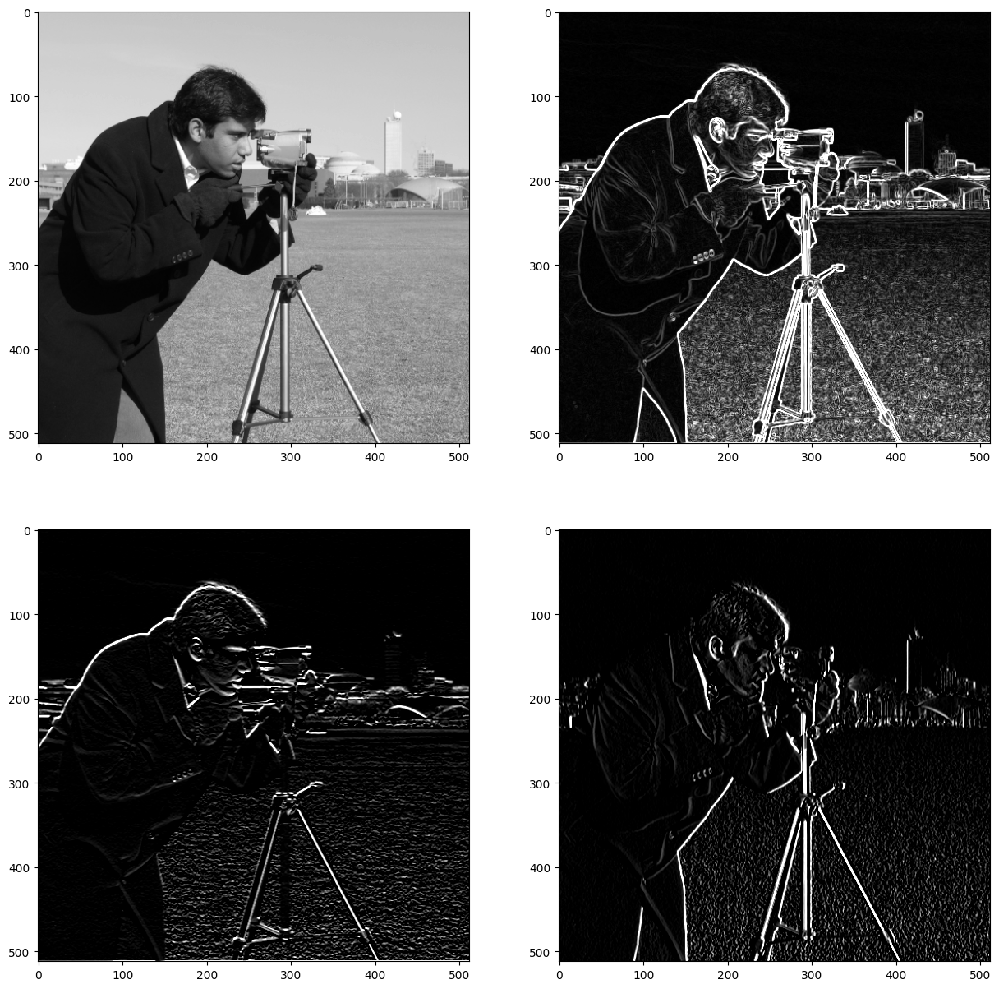

In [ ]:
camera = data.camera()
gradx = conv(camera, Sx, pad=1)
grady = conv(camera, Sy, pad=1)
normal = np.sqrt(gradx**2 + grady**2)

fig, axs = plt.subplots(2, 2, figsize=(15, 15))
axs[0, 0].imshow(camera, cmap="gray", vmin=0, vmax=255)
axs[0, 1].imshow(normal, cmap="gray", vmin=0, vmax=255)
axs[1, 0].imshow(grady, cmap="gray", vmin=0, vmax=255)
axs[1, 1].imshow(gradx, cmap="gray", vmin=0, vmax=255)

# Your code here

## Формат результата

Результатом являются 4 изображения, пример:

<img src ="https://edunet.kea.su/repo/EduNet-web_dependencies/dev-2.0/Exercises/EX06/result_1_task_ex06.png" width="500">


# Задание 2. Создание сверточной сети для  MNIST

Создайте сверточную сеть на PyTorch и обучите ее на MNIST.
* Используйте не более трёх [сверточных](https://pytorch.org/docs/stable/generated/torch.nn.Conv2d.html) и не более двух [полносвязных](https://pytorch.org/docs/stable/generated/torch.nn.Linear.html) слоев, а также слои [пулинга](https://pytorch.org/docs/stable/generated/torch.nn.MaxPool2d.html) (слой пулинга и аргумент `stride` у сверточных слоев помогут уменьшить число параметров линейного слоя).
* Не применяйте слои других типов.
* Функцию активации выберите на свое усмотрение.
* Рекомендуется использовать код для обучения из лекции №5.
* Отладку кода рекомендуем производить на небольшой части датасета (как обычно).

Импорт необходимых библиотек:

In [ ]:
!pip install -q torchmetrics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 805.2/805.2 kB 10.9 MB/s eta 0:00:00


In [ ]:
import torch
import torch.nn as nn
from torch.nn.modules.pooling import MaxPool2d, AdaptiveAvgPool2d
from torchvision import datasets, transforms, utils
from torch.utils.data import random_split, DataLoader
from IPython.display import clear_output
from tqdm import tqdm
import torchmetrics


Нейронная сеть:

In [ ]:
class MnistCNN(nn.Module):
    def __init__(self):
        super().__init__()
        self.layers_stack = torch.nn.Sequential(
            nn.Conv2d(
                in_channels=1, out_channels=3, kernel_size=5, padding='same'
            ),
            nn.ReLU(),
            MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False),
            nn.Conv2d(
                in_channels=3, out_channels=6, kernel_size=3, padding='same'
            ),
            nn.ReLU(),
            nn.Conv2d(
                in_channels=6, out_channels=12, kernel_size=3, padding='same'
            ),
            nn.ReLU(),
            AdaptiveAvgPool2d(output_size=(10, 10)),
            nn.Flatten(),
            nn.Linear(1200, 100),
            nn.ReLU(),
            nn.Linear(100, 10))

    def forward(self, x):
        return self.layers_stack(x)


Функция для подсчета точности.
Изменять код в данном блоке не требуется.

In [ ]:
def get_correct_count(pred, labels):
    _, predicted = torch.max(pred.data, 1)
    return (predicted.cpu() == labels.cpu()).sum().item()


@torch.inference_mode()  # this annotation disable grad computation
def validate(model, test_loader, device="cpu"):
    correct, total = 0, 0
    for imgs, labels in test_loader:
        pred = model(imgs.to(device))
        total += labels.size(0)
        correct += get_correct_count(pred, labels)
    return correct / total

Загрузите [MNIST](https://pytorch.org/vision/stable/generated/torchvision.datasets.MNIST.html#torchvision.datasets.MNIST):

In [ ]:
# Your code here

test_transform = transforms.Compose(
    [transforms.ToTensor(), transforms.Normalize((0.13), (0.3))]
)

train_data = datasets.MNIST(
    root="./", train=True, download=True, transform=test_transform
)
clear_output()

trainset, valset = random_split(train_data, lengths=[45000, 15000])

train_loader = DataLoader(trainset, batch_size=16, shuffle=True, num_workers=2)
val_loader = DataLoader(valset, batch_size=16, shuffle=False, num_workers=2)


Разместите код для обучения в этом блоке.

* Используйте GPU. Для этого Вам необходимо в верхней панели выбрать `Среда выполнения > Сменить среду выполнения` и заменить None на GPU.

* Для оценки точности используйте функцию `validate`.

* Подумайте над тем, чтобы поместить код для обучения в функцию или класс, который вы сможете использовать в следующих заданиях.

In [ ]:
def train_loop(dataloader, model, criterion, optimizer, score_function, device):
    num_batches = len(dataloader)

    train_loss = 0
    y_true, y_pred = torch.Tensor(), torch.Tensor()

    for imgs, labels in dataloader:
        pred =  model(imgs.to(device))
        loss =  criterion(pred, labels.to(device))

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()

        y_true = torch.cat([y_true, labels], dim=0)
        pred_labels = pred.detach().cpu().argmax(dim=1)
        y_pred = torch.cat([y_pred, pred_labels], dim=0)

    train_loss /= num_batches
    train_score = score_function(y_pred, y_true)

    return train_loss, train_score

In [ ]:
def val_loop(dataloader, model, criterion, score_function, device):
    num_batches = len(dataloader)

    val_loss = 0
    y_true, y_pred = torch.Tensor(), torch.Tensor()

    with torch.no_grad():
        for imgs, labels in dataloader:
            pred = model(imgs.to(device))
            loss = criterion(pred, labels.to(device))

            val_loss += loss.item()

            y_true = torch.cat([y_true, labels], dim=0)
            pred_labels = pred.detach().cpu().argmax(dim=1)
            y_pred = torch.cat([y_pred, pred_labels], dim=0)

    val_loss /= num_batches
    val_score = score_function(y_pred, y_true)

    return val_loss, val_score

In [ ]:
def train(model,
          train_loader,
          val_loader,
          criterion,
          optimizer,
          score_function,
          device,
          num_epochs=10):

    train_logger_loss = []
    train_logger_score = []
    val_logger_loss = []
    val_logger_score = []

    for i in tqdm(range(num_epochs)):

        # properly call train_loop and val_loop
        train_loss, train_score =  train_loop(train_loader, model, criterion, optimizer, score_function, device)
        val_loss, val_score = val_loop(val_loader, model, criterion, score_function, device)

        # logging
        train_logger_loss.append(train_loss)
        train_logger_score.append(train_score)
        val_logger_loss.append(val_loss)
        val_logger_score.append(val_score)

    return train_logger_loss, train_logger_score, val_logger_loss, val_logger_score


In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

Using device: cuda


Оценка результата на тестовой выборке:

In [ ]:
model = MnistCNN().to(device)  # Create model instance and move it to device

optimizer = torch.optim.SGD(model.parameters(), lr=0.05)  # Weights update algorithm
criterion = nn.CrossEntropyLoss()  # Loss function
score_function = torchmetrics.Accuracy(task="multiclass", num_classes=10)

train_logger_loss, train_logger_score, val_logger_loss, val_logger_score = train(model, train_loader,
                            val_loader, criterion, optimizer, score_function, device, num_epochs=10)


In [ ]:
train_logger_loss

[]

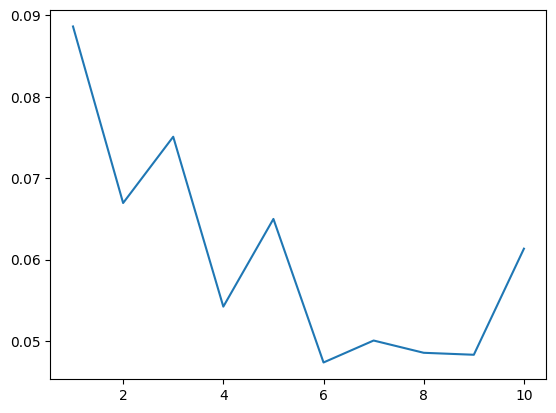

In [ ]:
plt.plot(range(1, len(val_logger_loss) + 1), val_logger_loss)

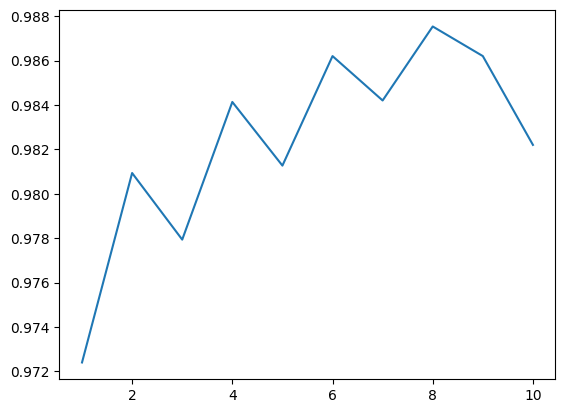

In [ ]:
plt.plot(range(1, len(val_logger_score) + 1), val_logger_score)

In [ ]:
testset = datasets.MNIST(root="./", train=False, download=True, transform = test_transform)
test_loader = torch.utils.data.DataLoader(testset, batch_size=512, shuffle=True)
accuracy = validate(model , test_loader, device)

print(f"Accuracy on TEST {accuracy:.2f}")

Accuracy on TEST 0.98


## Формат результата

Результатом является сверточная сеть, обученная на MNIST, с точностью не ниже 0.9

# Задание 3. Переход на Lightning

При обучении моделей в PyTorch нам постоянно приходится переписывать цикл обучения (train loop). Это дублирование кода, которое нарушает принцип [DRY](https://en.wikipedia.org/wiki/Don%27t_repeat_yourself).

Кроме того, нам нужно следить за процессом обучения модели. Например, если loss взрывается или выходит на плато, как правило, есть смысл остановить обучение. Чтобы контролировать этот процесс, приходится добавлять дополнительный код для вывода и/или логирования метрик.

При проведении реальных экспериментов логирование результатов станет необходимым. И в этом задании вы научитесь работать с фреймворком [Lightning](https://lightning.ai/), который облегчает написание train loop, логирование результатов, и.т.п.

Подзадачи:

1. Перепишите tain loop из задания №2 с использованием фреймворка [Lightning](https://lightning.ai/).
2. Выберите [один из инструментов для работы с логами](https://lightning.ai/docs/pytorch/stable/extensions/logging.html), который поддерживат Lightning, и инициализируйте его.
3. Обучите модель из второго задания. В процессе обучения сохраняйте в лог значения accuracy/train, accuracy/val и loss/train на каждой эпохе.
4. Выведите графики метрик, собранных во время выполнения п.3


Можно использовать пакет [torchmetrics](https://torchmetrics.readthedocs.io/en/stable/).

[Дополнительная информация про логирование метрик](https://lightning.ai/docs/pytorch/stable/extensions/logging.html#automatic-logging)

Установка и импорт необходимых библиотек

In [ ]:
!pip install -q lightning torchmetrics tbparse

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 13.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 776.9/776.9 kB 25.2 MB/s eta 0:00:00


In [ ]:
import torch
import torchmetrics
import lightning as L
import torch.nn as nn
import matplotlib.pyplot as plt

from torch import optim
from tbparse import SummaryReader
from torch.nn.modules.pooling import MaxPool2d
from torchvision import datasets, transforms, utils

### Инициализация инструмента для работы с логами

Выберите [инструмент для работы с логами](https://colab.research.google.com/corgiredirector?site=https%3A%2F%2Flightning.ai%2Fdocs%2Fpytorch%2Fstable%2Fextensions%2Flogging.html) и инициализируйте его в блоке кода ниже.

По умолчанию Lightning иcпользует[TensorBoard]( https://pytorch.org/docs/stable/tensorboard.html), его запуск в браузере иногда завершается ошибкой. Подробнее про этот инструмент можно прочесть здесь:
[Tensorboard](https://github.com/Gan4x4/ml_snippets/blob/main/Training/Tensorboard.ipynb)


In [ ]:
# Init logger

# Your code here
from lightning.pytorch import Trainer
from lightning.pytorch.loggers import TensorBoardLogger

#logger = TensorBoardLogger("tb_logs", name="my_model")
#trainer = Trainer(logger=logger)

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir=lightning_logs

<IPython.core.display.Javascript object>

In [ ]:
!kill 29792

/bin/bash: line 1: kill: (29792) - No such process


### Код LightningModule

Этим блоком мы заменим наш train loop из второго задания. Ваша задача — дописать недостающий код.

In [4]:
import lightning as L
from torch import optim
import torchmetrics

class LitBasic(L.LightningModule):
    def __init__(self, model):
        super().__init__()
        self.model = model
        self.train_acc = torchmetrics.Accuracy(task="multiclass", num_classes=10)
        self.valid_acc = torchmetrics.Accuracy(task="multiclass", num_classes=10)
        self.criterion = nn.CrossEntropyLoss()

    def configure_optimizers(self):
        optimizer = torch.optim.SGD(model.parameters(), momentum=0.9, lr=0.05)
        return optimizer

    def training_step(self, batch, batch_idx):
        inputs, target = batch
        output = self.model(inputs)
        loss = self.criterion(output, target.view(-1))
        self.train_acc.update(output, target)
        self.log("train_loss", loss, prog_bar=True)
        return loss

    def validation_step(self, batch, batch_idx):
        inputs, target = batch
        output = self.model(inputs)
        loss = self.criterion(output, target.view(-1))
        self.valid_acc.update(output, target)
        return loss

    def on_train_epoch_end(self):
        acc = self.train_acc.compute()
        self.log("train_acc", acc, prog_bar=True, on_epoch=True)
        self.train_acc.reset()


    def on_validation_epoch_end(self):
        acc = self.valid_acc.compute()
        self.log("valid_acc", acc, prog_bar=True, on_epoch=True)
        self.valid_acc.reset()

### Подготовка датасета

In [ ]:
transform = transforms.Compose(
    [transforms.ToTensor(), transforms.Normalize((0.13), (0.3))]
)

mnist = datasets.MNIST(root="./", train=True, download=True, transform=transform)

train_set, val_set, _ = torch.utils.data.random_split(mnist, [10000, 3000, 47000])

val_loader = torch.utils.data.DataLoader(val_set, batch_size=512, num_workers=2)
train_loader = torch.utils.data.DataLoader(train_set, batch_size=512, num_workers=2)

In [ ]:
L.seed_everything(42)
model = MnistCNN()
lit_model = LitBasic(model)
trainer = L.Trainer(max_epochs=10, log_every_n_steps=5)
trainer.fit(model=lit_model, train_dataloaders=train_loader, val_dataloaders=val_loader)

INFO: Seed set to 42
INFO:lightning.fabric.utilities.seed:Seed set to 42
INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name      | Type               | Params
-------------------------------------------------
0 | model     | MnistCNN           | 122 K 
1 | train_acc | MulticlassAccuracy | 0     
2 | valid_acc | MulticlassAccuracy | 0     
3 | criterion | CrossEntropyLoss   | 0     
-------------------

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO: `Trainer.fit` stopped: `max_epochs=10` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


Полученные логи можно конвертировать в pandas при помощи [tbparse](https://github.com/j3soon/tbparse) и отобразить, используя matplotlib.

Чтобы получить таблицу, где названия метрик соответствуют названиям столбцов, используем параметр `pivot=True`.

In [ ]:
from tbparse import SummaryReader

log_dir = trainer.logger.experiment.get_logdir()  # lightning_logs/version_x

reader = SummaryReader(log_dir, pivot=True)
df = reader.scalars
df.head()

,step,epoch,train_acc,train_loss,valid_acc
0,4,0.0,NaN,2.300693,NaN
1,9,0.0,NaN,2.294815,NaN
2,14,0.0,NaN,2.274872,NaN
3,19,"[0.0, 0.0, 0.0]",0.1877,2.173888,0.438333
4,24,1.0,NaN,1.244312,NaN


In [ ]:
plt.figure(figsize=(16, 3))

def drop_nan(df, tag):
    return df[~df[tag].isna()].loc[:, tag]

# Your code here

plt.show()

## Формат результата

Результатом является график, отрисованный при помощи выбранного вами инструмента. Пример:

<img src ="https://edunet.kea.su/repo/EduNet-web_dependencies/dev-2.0/Exercises/EX06/result_3_task_ex06.png" width="800">


# Задание 4. Собственные аугментации

В этом задании предлагается применить к датасету CIFAR-10 аугментации и визуализировать получившиеся результаты. Требуется воспользоваться готовыми аугментациями из `torchvision.transforms`, а также реализовать собственный метод для аугментации изображений.

Импорт необходимых библиотек:

In [ ]:
import torchvision
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
from torchvision import datasets, transforms

Функция для вывода изображений:

In [ ]:
def show_images(dataset, tag, img_count=32):
    """
    Helper method to display first img_count images from dataset
    """

    loader = DataLoader(dataset, batch_size=img_count)

    # Get first batch from dataloader
    dataiter = iter(loader)
    images, labels = next(dataiter)

    # create grid of images
    img_grid = torchvision.utils.make_grid(images)

    # plot
    plt.figure(figsize=(10, 7))
    plt.imshow(img_grid.permute((1, 2, 0)))
    plt.title(tag)
    plt.axis("off")
    plt.show()

Загрузите CIFAR-10 и:

* выберите два преобразования из [списка](https://pytorch.org/vision/stable/transforms.html),
* примените их к изображениям из датасета,
* выведите измененные изображения.


100%|██████████| 170498071/170498071 [00:05<00:00, 29223870.72it/s]


Extracting content/cifar-10-python.tar.gz to content


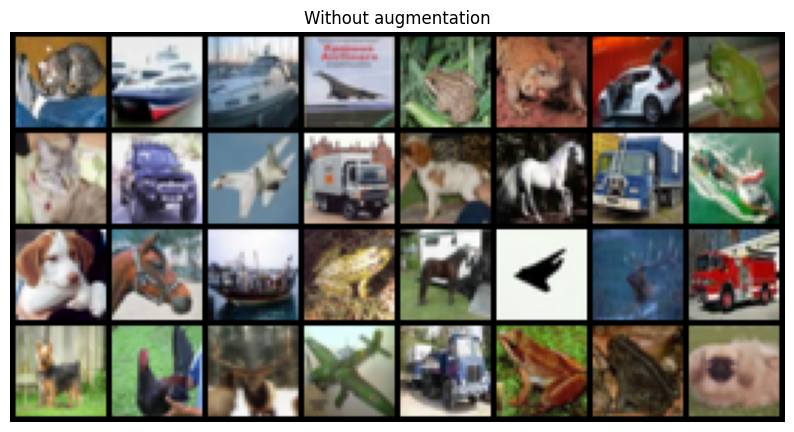

In [ ]:
testset = datasets.CIFAR10(
    "content",
    train=False,
    transform=transforms.Compose([transforms.ToTensor()]),
    download=True,
)

show_images(testset, "Without augmentation")

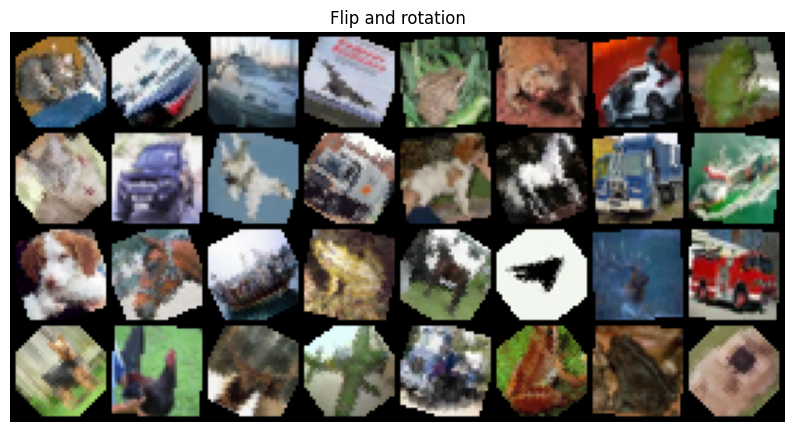

In [ ]:
base_augmentation = transforms.Compose(
    [
        transforms.ToTensor(),
        transforms.RandomHorizontalFlip(0.8),
        transforms.RandomRotation(45)
    ]
)

testset.transform = base_augmentation
show_images(testset, "Flip and rotation")

## Создание собственной аугментации
* Создайте собственную аугментацию, которой нет в `torchvision.transforms`. Например, сделайте изображение квадратным при помощи padding, или обнулите чать пикселей, или уменьшите изображение и затем восстановите его до прежнего размера ...

* Выведите измененные изображения. При использовании функции `show_images` обратите внимание, что список трансформаций должен содержать `transforms.ToTensor()`.

In [ ]:

def conv(x, kernel, pad):
    padded_x = np.zeros((x.shape[0] + 2*pad, x.shape[1] + 2*pad, x.shape[2]))  # create zeros array to insert image in center
    padded_x[pad:-pad, pad:-pad] += x
    convolution = np.zeros((padded_x.shape[0] - kernel.shape[0] + 1,
                           padded_x.shape[1] - kernel.shape[1] + 1,
                            x.shape[2]))

    for k in range(x.shape[2]):
        for i in range(padded_x.shape[0] - kernel.shape[0] + 1):
            for j in range(padded_x.shape[1] - kernel.shape[1] + 1):
                convolution[i, j, k] = np.sum(padded_x[i: i + kernel.shape[0], j: j + kernel.shape[1], k] * kernel) % 255

    return convolution

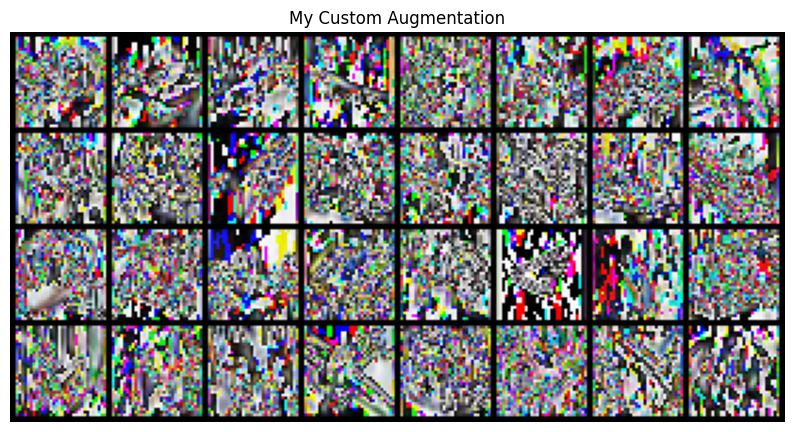

In [ ]:
# Your code here
from PIL import Image
import numpy as np


class ApplyKernel:
    """
    Apply kernel with optional padding
    """

    def __init__(self, kernel, pad):
        self.kernel = kernel
        self.pad = pad

    def __call__(self, pil_image):
        np_image = np.array(pil_image)
        return Image.fromarray(conv(np_image, self.kernel, self.pad).astype(np.uint8))

Sx = np.array([[-1, 0, 1],
               [-2, 0, 2],
               [-1, 0, 1]])

Sy = np.array([[1, 2, 1],
               [0, 0, 0],
               [-1, -2, -1]])

custom_augmentation = transforms.Compose(
    [
        ApplyKernel(kernel=Sx, pad=1),
        transforms.ToTensor(),
    ]
)

testset.transform = custom_augmentation
show_images(testset, "My Custom Augmentation")

In [ ]:
img = testset.data[0]

In [ ]:
pad = 1
x = img
padded_x = np.zeros((x.shape[0] + 2*pad, x.shape[1] + 2*pad, x.shape[2]))  # create zeros array to insert image in center
padded_x[pad:-pad, pad:-pad] += x
kernel = Sx
smth = Image.fromarray(conv(img, kernel, 1).astype(np.uint8))

In [ ]:
np.min(conv(img, kernel, 1))

0.0

In [ ]:
img.shape

(32, 32, 3)

In [ ]:
conv(img, kernel, 1).shape

(32, 32, 3)

## Формат результата

Выведенные изображения:
* без аугментаций,
* с двумя аугментациями из torchvision,
* со своей собственной аугментацией.

# Задание 5. Создание сверточной сети для CIFAR-10

Создайте сверточную сеть на PyTorch и обучите ее на СIFAR-10. Цель — получить лучшее качество, чем у полносвязной сети, которую мы обучали в 5-й лекции.

* Используйте не более трёх [сверточных](https://pytorch.org/docs/stable/generated/torch.nn.Conv2d.html) и не более двух [полносвязных](https://pytorch.org/docs/stable/generated/torch.nn.Linear.html) слоев, а также один слой [пулинга](https://pytorch.org/docs/stable/generated/torch.nn.MaxPool2d.html) между ними (слой пулинга и аргумент `stride` у сверточных слоев помогут сжать карту признаков).
* Не применяйте слои других типов.
* Функцию активации выберите на свое усмотрение.
* Допустимо применить аугментации к входным данным.

Импорт необходимых библиотек:

In [1]:
!pip install -q torchmetrics lightning

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 805.2/805.2 kB 6.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 13.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 776.9/776.9 kB 20.4 MB/s eta 0:00:00


In [2]:
import torch
import torchmetrics
import torch.nn as nn
import lightning as L

from torch import optim
from torchsummary import summary
from torch.nn.modules.pooling import MaxPool2d
from torchvision import datasets, transforms, utils

Завершите реализацию модели

In [3]:
class CifarCNN(nn.Module):
    def __init__(self):
        super().__init__()
        self.layers_stack = nn.Sequential(
            nn.Conv2d(
                in_channels=3, out_channels=9, kernel_size=5, padding='same'
            ),
            nn.ReLU(),
            nn.Conv2d(
                in_channels=9, out_channels=27, kernel_size=3, padding='same'
            ),
            nn.ReLU(),
            nn.Conv2d(
                in_channels=27, out_channels=54, kernel_size=3, padding='same'
            ),
            nn.ReLU(),
            nn.AdaptiveMaxPool2d(output_size=(10, 10)),
            nn.Flatten(),
            nn.Linear(54*10*10, 512),
            nn.ReLU(),
            nn.Linear(512, 10))

    def forward(self, x):
        return self.layers_stack(x)


В данной реализации я в итоге использовал AdaptiveMaxPool (изначально использовал MaxPool, но там были проблемы с размерностями, потом уже понял, что это было из-за того, что при копировании transform там была аугментация Resize).

In [4]:
import math


# вспомогательная функция для расчета размерности после применения MaxPool
# формула взята из документации
def maxpool_dims(H, W, padding, dilation, kernel, stride):
    pad = (padding, padding) if type(padding) != tuple else padding
    dil = (dilation, dilation) if type(dilation) != tuple else dilation
    ker = (kernel, kernel) if type(kernel) != tuple else kernel
    std = (stride, stride) if type(stride) != tuple else stride

    Ho = math.floor((H + 2*pad[0] - dil[0]*(ker[0] - 1) - 1) / std[0] + 1)
    Wo = math.floor((W + 2*pad[1] - dil[1]*(ker[1] - 1) - 1) / std[1] + 1)
    return Ho, Wo


Загрузите CIFAR-10:

In [4]:
# Your code here
from torchvision.datasets import CIFAR10
from torchvision.transforms import ToTensor, Resize, Normalize, Compose
from torch.utils.data import DataLoader, random_split

torch.manual_seed(42)

transform = Compose(
    [ToTensor(), Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])]
)


dataset = CIFAR10(root="./CIFAR10", train=True, download=True, transform=transform)

100%|██████████| 170498071/170498071 [00:01<00:00, 96410721.38it/s] 


Extracting ./CIFAR10/cifar-10-python.tar.gz to ./CIFAR10


In [12]:
trainset, valset = random_split(dataset, [35000, 15000])

batch_size = 256

train_loader = DataLoader(trainset, batch_size=batch_size, shuffle=True, num_workers=2)
val_loader = DataLoader(valset, batch_size=batch_size, shuffle=False, num_workers=2)

Разместите код для обучения в этом блоке.

* Используйте GPU. Для этого Вам необходимо в верхней панели выбрать `Среда выполнения > Сменить среду выполнения` и заменить `Hardware accelerator` на T4 GPU или другой доступный GPU ускоритель.

* Используйте Lightning. Рекомендуем унаследоваться от класса `LitBasic` из задания №3 и реализовать в классе-наследнике методы для проверки результатов на тестовом датасете. Можете использовать `self.valid_acc` или определить другой атрибут класса.

In [6]:
class LitBasic(L.LightningModule):
    def __init__(self, model):
        super().__init__()
        self.model = model
        self.train_acc = torchmetrics.Accuracy(task="multiclass", num_classes=10)
        self.valid_acc = torchmetrics.Accuracy(task="multiclass", num_classes=10)
        self.criterion = nn.CrossEntropyLoss()

    def configure_optimizers(self):
        optimizer = torch.optim.SGD(model.parameters(), momentum=0.9, lr=0.05)
        return optimizer

    def training_step(self, batch, batch_idx):
        inputs, target = batch
        output = self.model(inputs)
        loss = self.criterion(output, target.view(-1))
        self.train_acc.update(output, target)
        self.log("train_loss", loss, prog_bar=True)
        return loss

    def validation_step(self, batch, batch_idx):
        inputs, target = batch
        output = self.model(inputs)
        loss = self.criterion(output, target.view(-1))
        self.valid_acc.update(output, target)
        return loss

    def on_train_epoch_end(self):
        acc = self.train_acc.compute()
        self.log("train_acc", acc, prog_bar=True, on_epoch=True)
        self.train_acc.reset()


    def on_validation_epoch_end(self):
        acc = self.valid_acc.compute()
        self.log("valid_acc", acc, prog_bar=True, on_epoch=True)
        self.valid_acc.reset()

In [7]:
class LitTest(LitBasic):

    def __init__(self, model):
        super().__init__(model)
        self.test_acc = torchmetrics.Accuracy(task="multiclass", num_classes=10)

    def test_step(self, batch, batch_idx):
        inputs, target = batch
        output = self.model(inputs)
        loss = self.criterion(output, target.view(-1))
        self.test_acc.update(output, target)
        return loss

    def on_test_epoch_end(self):
        acc = self.test_acc.compute()
        self.log("test_acc", acc, prog_bar=True, on_epoch=True)
        self.test_acc.reset()

In [8]:
%load_ext tensorboard

In [9]:
%tensorboard --logdir=lightning_logs

<IPython.core.display.Javascript object>

In [13]:
# Your code here
L.seed_everything(42)
model = CifarCNN()
lit_model = LitTest(model)
trainer = L.Trainer(max_epochs=10, log_every_n_steps=5)
trainer.fit(model=lit_model, train_dataloaders=train_loader, val_dataloaders=val_loader)

INFO: Seed set to 42
INFO:lightning.fabric.utilities.seed:Seed set to 42
INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name      | Type               | Params
-------------------------------------------------
0 | model     | CifarCNN           | 2.8 M 
1 | train_acc | MulticlassAccuracy | 0     
2 | valid_acc | MulticlassAccuracy | 0     
3 | criterion | CrossEntropyLoss   | 0     
4 | test_acc  | Mul

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO: `Trainer.fit` stopped: `max_epochs=10` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


## Оценка результата на тестовой выборке

Загрузите тестовую часть датасета и используйте метод `trainer.test`

In [14]:
# Your code here
testset = CIFAR10(root="./CIFAR10", train=False, download=True, transform=transform)
test_loader = DataLoader(testset, batch_size=batch_size, shuffle=False, num_workers=2)
trainer.test(dataloaders=test_loader)

Files already downloaded and verified


INFO: Restoring states from the checkpoint path at /content/lightning_logs/version_1/checkpoints/epoch=9-step=1370.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Restoring states from the checkpoint path at /content/lightning_logs/version_1/checkpoints/epoch=9-step=1370.ckpt
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: Loaded model weights from the checkpoint at /content/lightning_logs/version_1/checkpoints/epoch=9-step=1370.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Loaded model weights from the checkpoint at /content/lightning_logs/version_1/checkpoints/epoch=9-step=1370.ckpt


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_acc          │    0.6769999861717224     │
└───────────────────────────┴───────────────────────────┘

[{'test_acc': 0.6769999861717224}]

В результате точность сверточной сети, обученной на 35000 объектах, составила 0.67 на тестовой выборке.

## Формат результата

Результатом является сверточная сеть, обученная на CIFAR-10, с точностью не ниже 0.6